# Фильтрация изображений

Чтобы при запуске корректно подгрузились все объясняющие изображения в текстовых блоках, может понадобиться включение VPN

In [1]:
import time
import math
from math import sqrt, exp
import numpy as np
from skimage import io
import plotly.graph_objects as go
import cv2

import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import scipy.ndimage as ndi

## 1. Пространственная фильтрация
## 1.1. Создание шумов

In [2]:
# Считаем исходное изображение
image_init = io.imread("Angiogramma_iskhodnaya.bmp", as_gray=True)

In [3]:
# Сгенерируем гауссов шум
mu = 0
sigma = 0.1
noise_g = np.random.normal(mu, sigma, (image_init.shape[0], image_init.shape[1]))

# Добавим гауссов шум на исходное изображение
image_noised_g = image_init + noise_g

In [4]:
# Сгенерируем шум по типу "Соль и перец"
size_salt = 35000
I_s_x = np.random.randint(0, image_init.shape[0], size_salt)
I_s_y = np.random.randint(0, image_init.shape[1], size_salt)

# Перец
size_pepper = 30000
I_p_x = np.random.randint(0, image_init.shape[0], size_pepper)
I_p_y = np.random.randint(0, image_init.shape[1], size_pepper)

image_noised_sp = np.array(image_init)
# Добавим соли
for i in range(0, I_s_y.shape[0]):
    image_noised_sp[I_s_x[i],I_s_y[i]] = 1.0

# Добавим перца
for i in range(0, I_p_y.shape[0]):
    image_noised_sp[I_p_x[i],I_p_y[i]] = 0.0

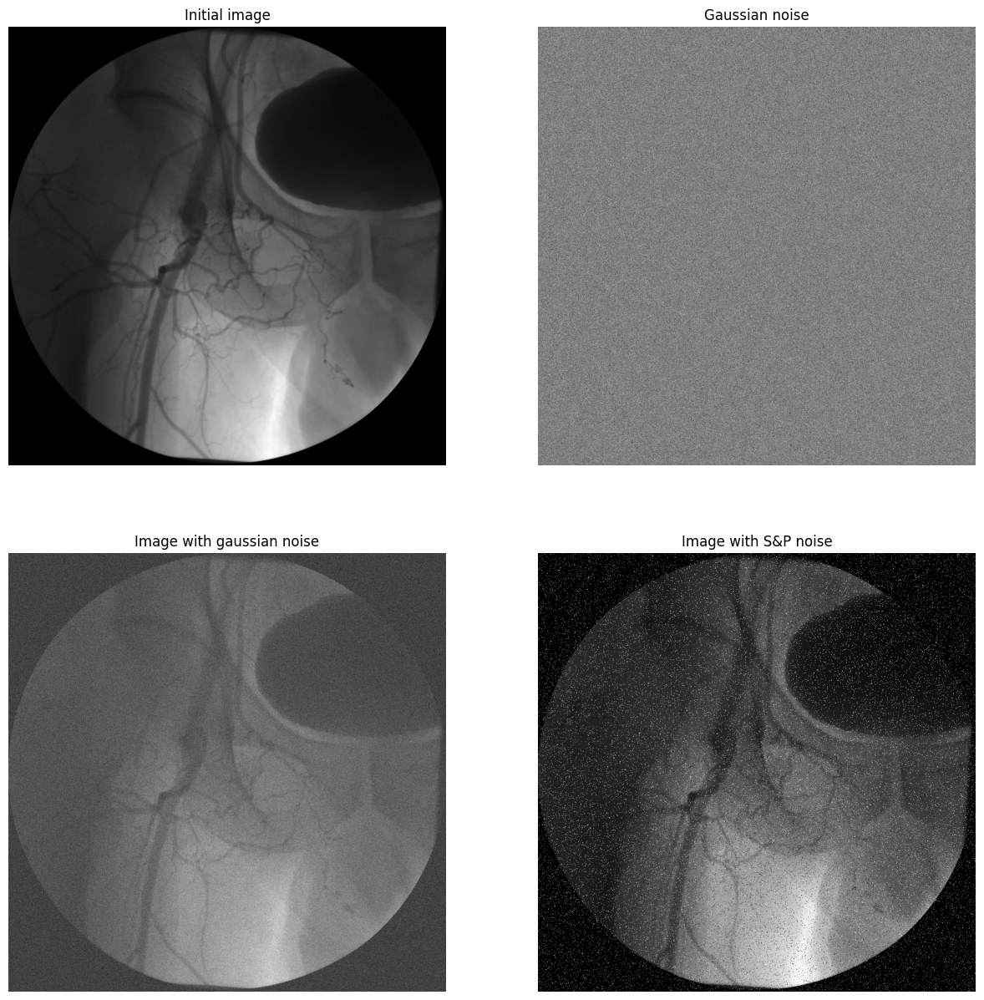

In [5]:
fig, axs = plt.subplots(2, 2, figsize=(15,15))
axs[0, 0].imshow(image_init, cmap="gray")
axs[0, 0].title.set_text(f'Initial image')
axs[0, 0].axis("off")

axs[0, 1].imshow(noise_g, cmap="gray")
axs[0, 1].title.set_text(f'Gaussian noise')
axs[0, 1].axis("off")

axs[1, 0].imshow(image_noised_g, cmap="gray")
axs[1, 0].title.set_text(f'Image with gaussian noise')
axs[1, 0].axis("off")

axs[1, 1].imshow(image_noised_sp, cmap="gray")
axs[1, 1].title.set_text(f'Image with S&P noise')
axs[1, 1].axis("off")
plt.show()

In [6]:
def getPSNR(I1, I2):
    """
    Higher - better
    """
    s1 = cv2.absdiff(I1, I2) #|I1 - I2|
    s1 = np.float32(s1)     # cannot make a square on 8 bits
    s1 = s1 * s1            # |I1 - I2|^2
    sse = s1.sum()          # sum elements per channel
    if sse <= 1e-10:        # sum channels
        print("The same image")            # for small values return zero
        return 0
    else:
        shape = I1.shape
        mse = 1.0 * sse / (shape[0] * shape[1])
        psnr = 10.0 * np.log10((255 * 255) / mse)
        print(f"Signal to noise ratio (higher - better): {psnr: .2f}")
        return psnr

In [7]:
print("Gaussian noised")
_ = getPSNR(image_init, image_noised_g)

Gaussian noised
Signal to noise ratio (higher - better):  68.13


In [8]:
print("S&P noised")
_ = getPSNR(image_init, image_noised_sp)

S&P noised
Signal to noise ratio (higher - better):  64.51


Рассмотрим зависимость показателя пикового значения сигнал - шум от дисперсии гауссового шума

In [9]:
mu = 0
sigma_list = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5, 0.7, 0.9]
image_noise_g_arr = [image_init + np.random.normal(mu, sigma_val, (image_init.shape[0], image_init.shape[1]))
                     for sigma_val in sigma_list]
psnr_list = [getPSNR(image_init, noised_image) for noised_image in image_noise_g_arr]

Signal to noise ratio (higher - better):  88.13
Signal to noise ratio (higher - better):  74.15
Signal to noise ratio (higher - better):  68.12
Signal to noise ratio (higher - better):  62.11
Signal to noise ratio (higher - better):  58.60
Signal to noise ratio (higher - better):  54.15
Signal to noise ratio (higher - better):  51.23
Signal to noise ratio (higher - better):  49.05


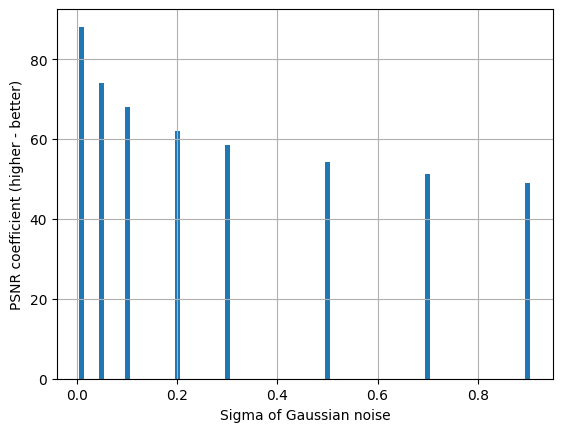

In [10]:
plt.bar(sigma_list, psnr_list, width=0.01)
plt.grid()
plt.xlabel("Sigma of Gaussian noise")
plt.ylabel("PSNR coefficient (higher - better)")
plt.plot()
plt.show()

## 1.2. Линейные низкочастотные фильтры
Улучшим качество зашумленного изображения с помощью линейных низкочастотных фильтров.  
Сглаживающий фильтр №1

In [11]:
def plot_filtered_images(filtered_gaussian, filtered_sp):
    fig, axs = plt.subplots(2, 2, figsize=(15,15))
    axs[0, 0].imshow(image_noised_g, cmap="gray")
    axs[0, 0].title.set_text(f'Image with gaussian noise')
    axs[0, 0].axis("off")

    axs[0, 1].imshow(filtered_gaussian, cmap="gray")
    axs[0, 1].title.set_text(f'Filtered gaussian noise')
    axs[0, 1].axis("off")

    axs[1, 0].imshow(image_noised_sp, cmap="gray")
    axs[1, 0].title.set_text(f'Image with S&P noise')
    axs[1, 0].axis("off")

    axs[1, 1].imshow(filtered_sp, cmap="gray")
    axs[1, 1].title.set_text(f'Filtered S&P noise')
    axs[1, 1].axis("off")
    plt.show()

In [12]:
H_1 = np.array([[ 1, 2, 1],
                [ 2, 4, 2],
                [ 1, 2, 1]])
H_1_coef = 1/16

image_noised_g_H1 = ndi.convolve(image_noised_g, H_1)*H_1_coef
image_noised_sp_H1 = ndi.convolve(image_noised_sp, H_1)*H_1_coef

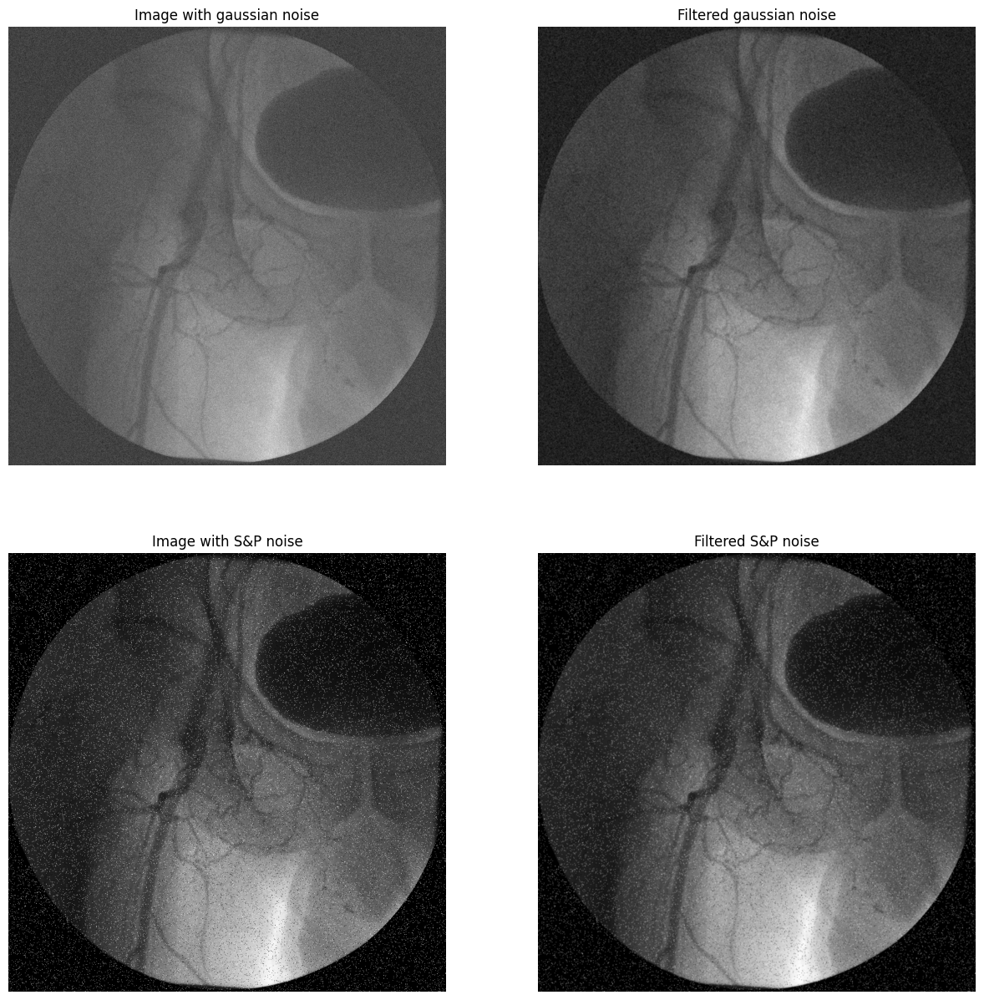

Filtered Gaussian noised
Signal to noise ratio (higher - better):  76.57
Filtered S&P noised
Signal to noise ratio (higher - better):  72.48


In [13]:
plot_filtered_images(image_noised_g_H1, image_noised_sp_H1)
print("Filtered Gaussian noised")
_ = getPSNR(image_init, image_noised_g_H1)

print("Filtered S&P noised")
_ = getPSNR(image_init, image_noised_sp_H1)

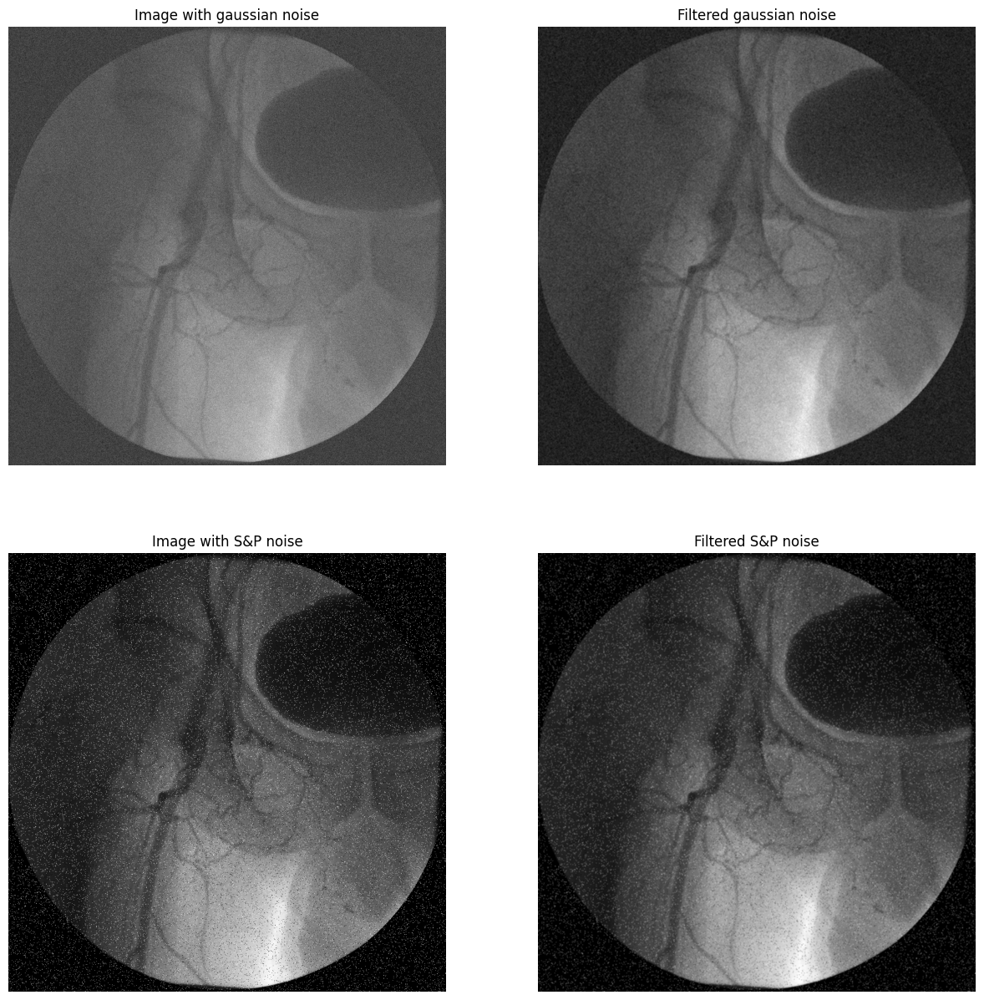

Filtered Gaussian noised
Signal to noise ratio (higher - better):  77.14
Filtered S&P noised
Signal to noise ratio (higher - better):  72.98


In [14]:
H_2 = np.array([[ 2, 1, 2],
                [ 1, 2, 1],
                [ 2, 1, 2]])
H_2_coef = 1/14

image_noised_g_H2 = ndi.convolve(image_noised_g, H_2)*H_2_coef
image_noised_sp_H2 = ndi.convolve(image_noised_sp, H_2)*H_2_coef

plot_filtered_images(image_noised_g_H2, image_noised_sp_H2)
print("Filtered Gaussian noised")
_ = getPSNR(image_init, image_noised_g_H2)

print("Filtered S&P noised")
_ = getPSNR(image_init, image_noised_sp_H2)

Оценим визуально эффект от увеличения размера окна усредняющего фильтра

In [15]:
image_test = io.imread("test_image.png", as_gray=True)

In [16]:
win_sizes = [3, 5, 9, 15, 35]

filters = [np.ones((size, size)) for size in win_sizes]

filt_coef = [1/val**2 for val in win_sizes]

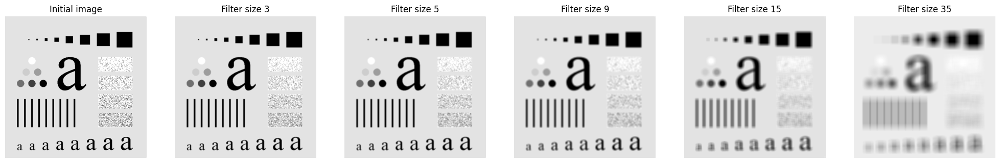

In [17]:
fig, axs = plt.subplots(1, 6, figsize=(25,25))

axs[0].imshow(image_test, cmap="gray")
axs[0].title.set_text(f'Initial image')
axs[0].axis("off")

for i in range(len(win_sizes)):
    axs[i+1].imshow(ndi.convolve(image_test, filters[i])*filt_coef[i],
                    cmap="gray")
    axs[i+1].title.set_text(f'Filter size {win_sizes[i]}')
    axs[i+1].axis("off")
    
plt.show()

## 1.3. Нелинейные низкочастотные фильтры
Воспользуемся медианной фильтрацией

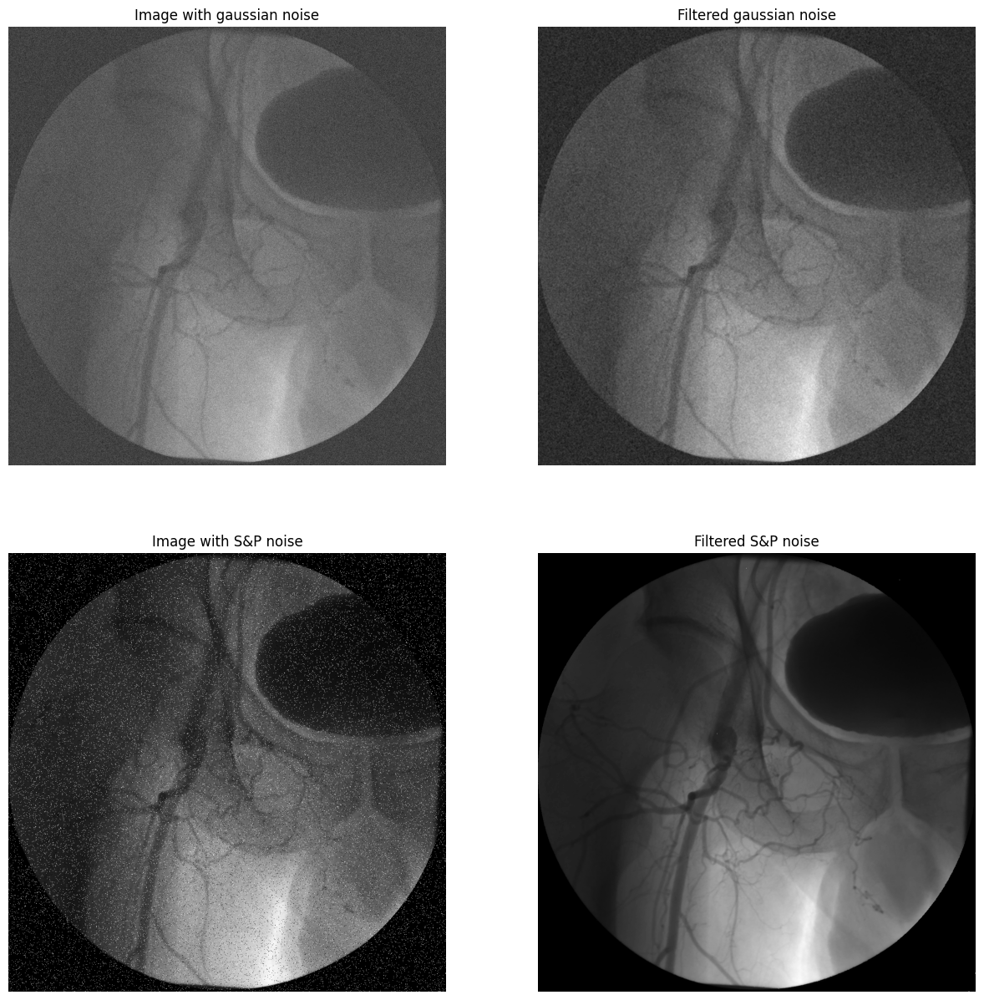

Filtered Gaussian noised
Signal to noise ratio (higher - better):  75.86
Filtered S&P noised
Signal to noise ratio (higher - better):  94.44


In [18]:
win_size = 3

image_noised_g_median = ndi.median_filter(image_noised_g, win_size)

image_noised_sp_median = ndi.median_filter(image_noised_sp, win_size)

plot_filtered_images(image_noised_g_median, image_noised_sp_median)
print("Filtered Gaussian noised")
_ = getPSNR(image_init, image_noised_g_median)

print("Filtered S&P noised")
_ = getPSNR(image_init, image_noised_sp_median)

Увеличим размер окна фильтра

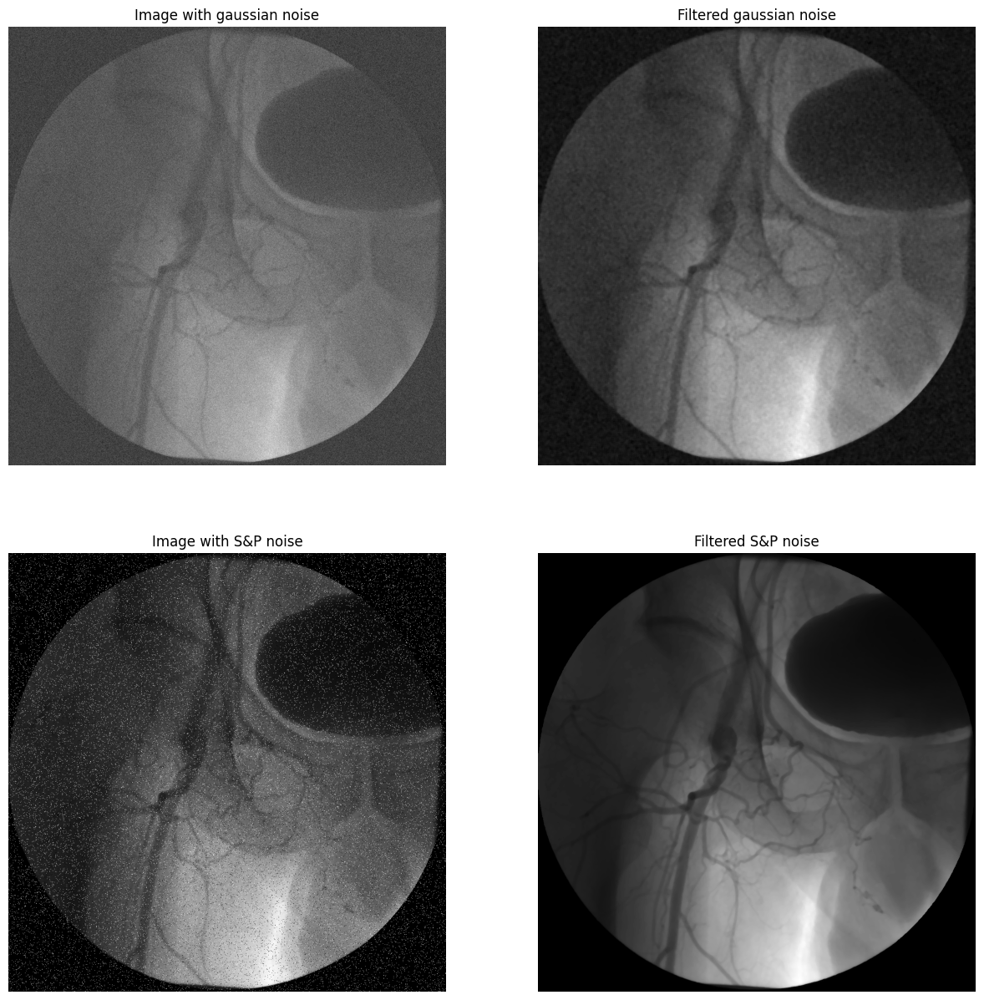

Filtered Gaussian noised
Signal to noise ratio (higher - better):  82.36
Filtered S&P noised
Signal to noise ratio (higher - better):  92.96


In [19]:
win_size = 7

image_noised_g_median = ndi.median_filter(image_noised_g, win_size)

image_noised_sp_median = ndi.median_filter(image_noised_sp, win_size)

plot_filtered_images(image_noised_g_median, image_noised_sp_median)
print("Filtered Gaussian noised")
_ = getPSNR(image_init, image_noised_g_median)

print("Filtered S&P noised")
_ = getPSNR(image_init, image_noised_sp_median)

## 1.4. Высокочастотные фильтры
Усилим контуры исходного изображения с помощью линейных высокочастотных фильтров.  
Начнем с фильтров, выделяющих границы по заданному направлению.

In [20]:
# North
H_n = np.array([[ 1, 1, 1],
                [ 1,-2, 1],
                [-1,-1,-1]])
image_n = ndi.convolve(image_init, H_n)

# North-East
H_ne = np.array([[ 1, 1, 1],
                [-1,-2, 1],
                [-1,-1, 1]])
image_ne = ndi.convolve(image_init, H_ne)

# East
H_e = np.array([[-1, 1, 1],
                [-1,-2, 1],
                [-1, 1, 1]])
image_e = ndi.convolve(image_init, H_e)

# South-East
H_se = np.array([[-1,-1, 1],
                [-1,-2, 1],
                [ 1, 1, 1]])
image_se = ndi.convolve(image_init, H_se)

# South
H_s = np.array([[-1,-1,-1],
                [ 1,-2, 1],
                [ 1, 1, 1]])
image_s = ndi.convolve(image_init, H_s)

# South-West 
H_sw = np.array([[ 1,-1,-1],
                 [ 1,-2,-1],
                 [ 1, 1, 1]])
image_sw = ndi.convolve(image_init, H_sw)

# West
H_w = np.array([[ 1, 1,-1],
                 [ 1,-2,-1],
                 [ 1, 1,-1]])
image_w = ndi.convolve(image_init, H_w)

# North-West
H_nw = np.array([[ 1, 1, 1],
                 [ 1,-2,-1],
                 [ 1,-1,-1]])

image_nw = ndi.convolve(image_init, H_nw)

# Resulting image
image_enhanced = image_init-(image_n/image_n.max() + image_ne/image_ne.max() + image_e/image_e.max() + 
                  image_se/image_se.max() + image_s/image_s.max() - image_sw/image_sw.max() - 
                  image_w/image_w.max() - image_nw/image_nw.max())

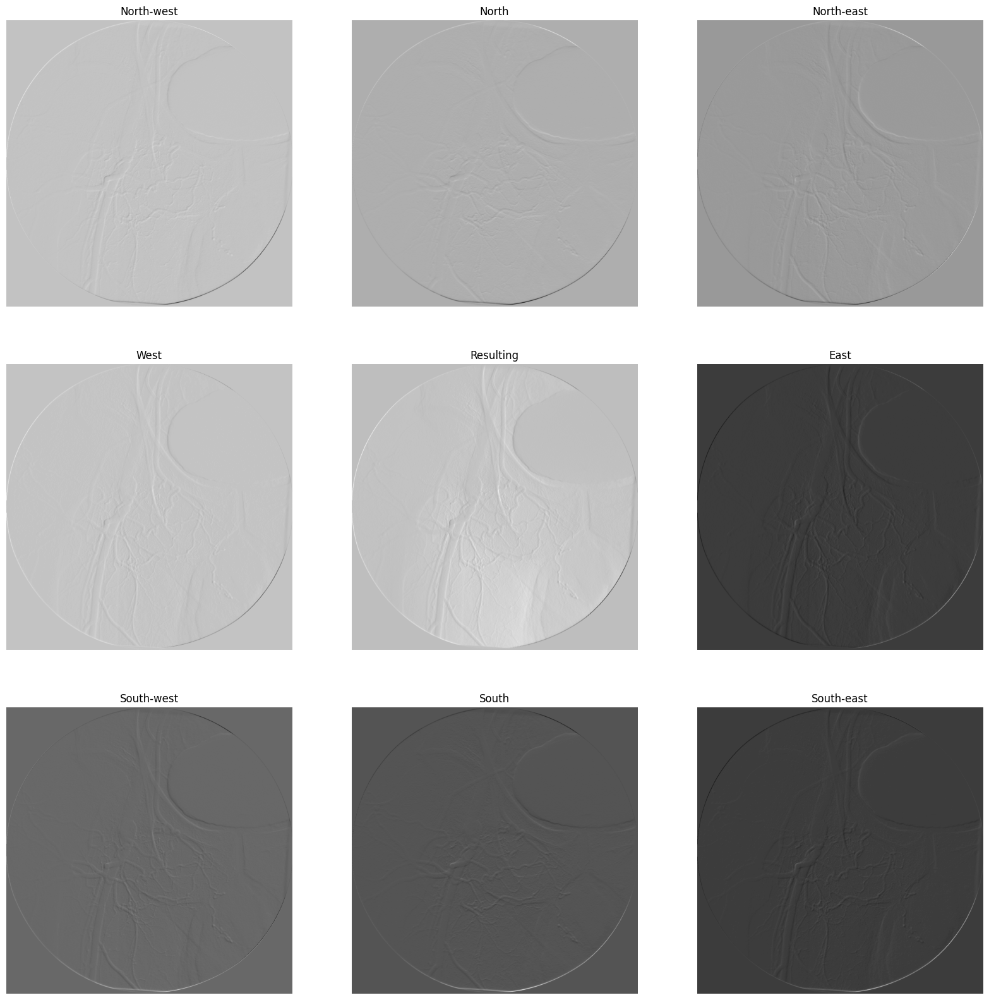

In [21]:
fig, axs = plt.subplots(3, 3, figsize=(20,20))

axs[0, 0].imshow(image_nw, cmap="gray")
axs[0, 0].title.set_text(f'North-west')
axs[0, 0].axis("off")

axs[0, 1].imshow(image_n, cmap="gray")
axs[0, 1].title.set_text(f'North')
axs[0, 1].axis("off")

axs[0, 2].imshow(image_ne, cmap="gray")
axs[0, 2].title.set_text(f'North-east')
axs[0, 2].axis("off")

axs[1, 0].imshow(image_w, cmap="gray")
axs[1, 0].title.set_text(f'West')
axs[1, 0].axis("off")

axs[1, 1].imshow(image_enhanced, cmap="gray")
axs[1, 1].title.set_text(f'Resulting')
axs[1, 1].axis("off")

axs[1, 2].imshow(image_e, cmap="gray")
axs[1, 2].title.set_text(f'East')
axs[1, 2].axis("off")

axs[2, 0].imshow(image_sw, cmap="gray")
axs[2, 0].title.set_text(f'South-west')
axs[2, 0].axis("off")

axs[2, 1].imshow(image_s, cmap="gray")
axs[2, 1].title.set_text(f'South')
axs[2, 1].axis("off")

axs[2, 2].imshow(image_se, cmap="gray")
axs[2, 2].title.set_text(f'South-east')
axs[2, 2].axis("off")
plt.show()

## 1.5. Использование производных первого порядка для (нелинейного) повышения резкости изображений

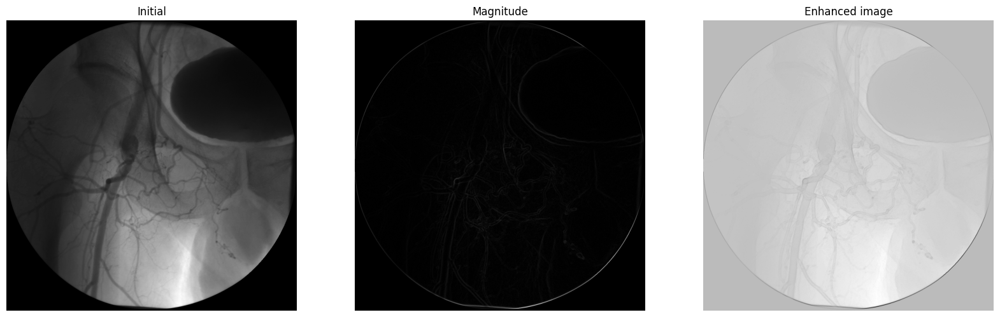

In [22]:
# Зададим горизонтальный фильтр Собеля
Sobel_h = np.array([[-1,-2,-1],
                    [0, 0, 0],
                    [1, 2,1]])
# Зададим вертикальный фильтр Собеля
Sobel_v = np.array([[-1,0,1],
                    [-2,0,2],
                    [-1,0,1]])

image_sobel_h = ndi.convolve(image_init, Sobel_h)
image_sobel_v = ndi.convolve(image_init, Sobel_v)
image_sobel = np.sqrt(np.square(image_sobel_h) + np.square(image_sobel_v))

fig, axs = plt.subplots(1, 3, figsize=(20,20))
axs[0].imshow(image_init, cmap="gray")
axs[0].title.set_text(f'Initial')
axs[0].axis("off")

axs[1].imshow(image_sobel, cmap="gray")
axs[1].title.set_text(f'Magnitude')
axs[1].axis("off")

axs[2].imshow(image_init-image_sobel, cmap="gray")
axs[2].title.set_text(f'Enhanced image')
axs[2].axis("off")
plt.show()

## 1.6. Применение последовательности преобразований

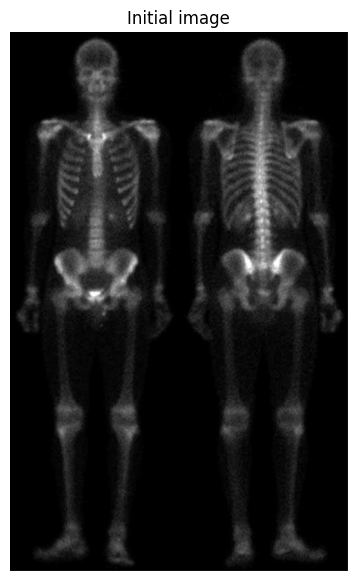

In [23]:
image_xray = io.imread("xray.png", as_gray=True)
plt.figure(figsize=(7, 7))
plt.imshow(image_xray, cmap="gray")
plt.axis("off")
plt.title("Initial image")
plt.show()

Применим лапласиан

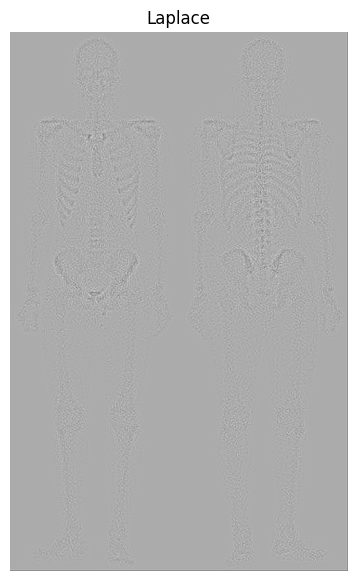

In [24]:
image_xray_lapl = cv2.Laplacian(image_xray, cv2.CV_64F)
plt.figure(figsize=(7, 7))
plt.imshow(image_xray_lapl, cmap="gray")
plt.axis("off")
plt.title("Laplace")
plt.show()

Сложим исходное изображение с результатом применения Лапласиана

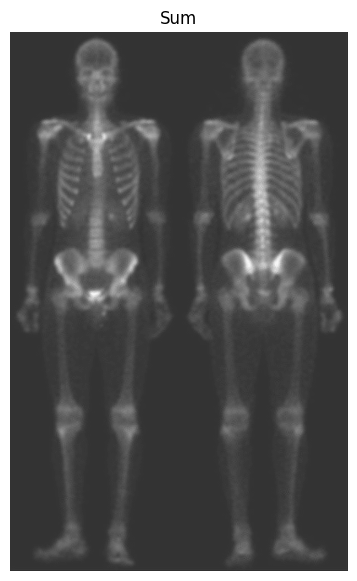

In [25]:
image_xray_sum = image_xray + image_xray_lapl

plt.figure(figsize=(7, 7))
plt.imshow(image_xray_sum, cmap="gray")
plt.axis("off")
plt.title("Sum")
plt.show()

Применим градиентный оператор Собеля к исходному изображению

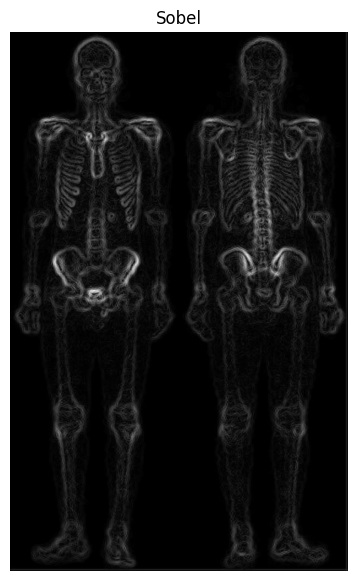

In [26]:
sobelx = cv2.Sobel(image_xray_sum, cv2.CV_64F, 1, 0, ksize=5)
sobely = cv2.Sobel(image_xray_sum, cv2.CV_64F, 0, 1, ksize=5)
image_xray_sobel = np.sqrt(sobelx**2 + sobely**2)

plt.figure(figsize=(7, 7))
plt.imshow(image_xray_sobel, cmap="gray")
plt.axis("off")
plt.title("Sobel")
plt.show()

Применим усредняющий фильтр 5х5 к результату применения оператора Собеля

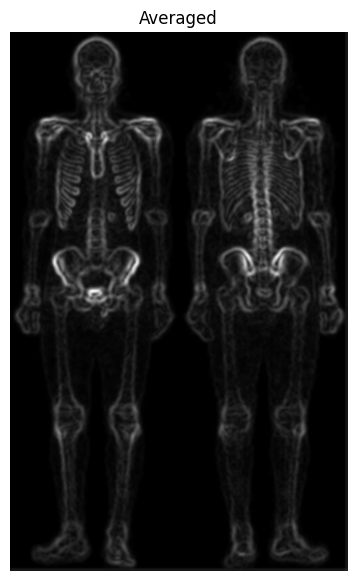

In [27]:
mean_filter = np.ones((5,5))
mean_coef = 1/25
image_xray_mean = ndi.convolve(image_xray_sobel, mean_filter)*mean_coef

plt.figure(figsize=(7, 7))
plt.imshow(image_xray_mean, cmap="gray")
plt.axis("off")
plt.title("Averaged")
plt.show()

Перемножим просуммированное и усредненное изображения

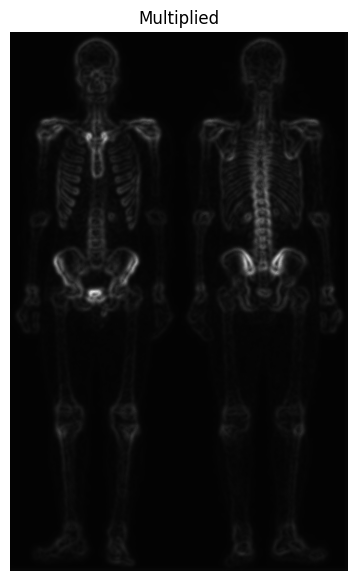

In [28]:
image_xray_mult = image_xray_sum * image_xray_mean

plt.figure(figsize=(7, 7))
plt.imshow(image_xray_mult, cmap="gray")
plt.axis("off")
plt.title("Multiplied")
plt.show()

Просуммируем исходное и полученные изображения

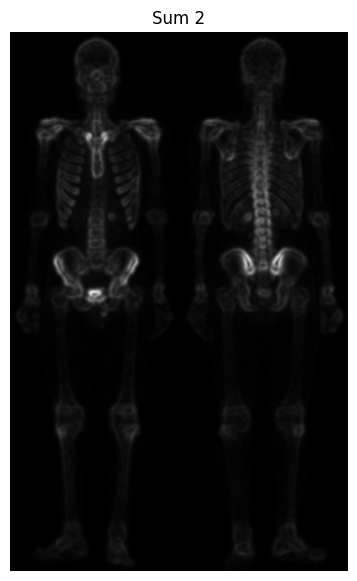

In [29]:
image_xray_sum2 = image_xray + image_xray_mult

plt.figure(figsize=(7, 7))
plt.imshow(image_xray_sum2, cmap="gray")
plt.axis("off")
plt.title("Sum 2")
plt.show()

Выполним градационное преобразование яркости

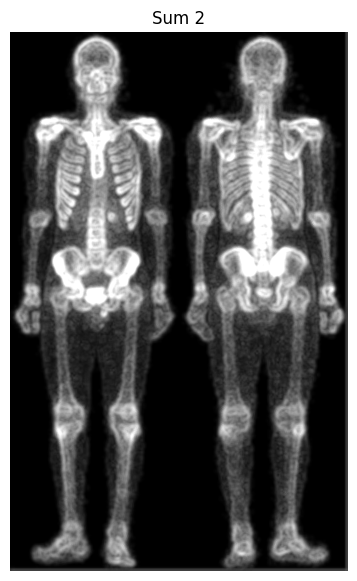

In [30]:
mid = 0.9
mean = np.mean(image_xray_sum2)
gamma = math.log(mid)/math.log(mean)

# do gamma correction
img_gamma1 = np.power(image_xray_sum2, gamma).clip(0,1.1)

plt.figure(figsize=(7, 7))
plt.imshow(img_gamma1, cmap="gray")
plt.axis("off")
plt.title("Sum 2")
plt.show()

## 2. Дискретное преобразование Фурье
Преобразование Фурье - это математический метод анализа частотных составляющих одномерного сигнала, такого как звук или радиоволна. Применяя преобразование Фурье к такому сигналу, который является информацией во временной области, мы можем узнать, например, какая составляющая 3000 Гц включена в сигнал.
<img src="https://miro.medium.com/max/3600/1*7ext1-8mQCbNRVQdXAhblQ.png" width="600" height="600">  
  
Но его также можно применять к двумерной информации, например к изображениям. Этот тип преобразования Фурье называется двумерным преобразованием Фурье.
## 2.1. Понимание двумерного ДПФ
Двумерное преобразование Фурье - это тип преобразования Фурье, который принимает на вход двумерные данные (двумерный массив чисел) и возвращает другие двумерные данные. Обычно мы используем это двумерное преобразование Фурье для изображений.  
Каждый элемент результата преобразования - комплексное число. Поэтому мы обычно берем абсолютные значения вывода, чтобы его можно было отобразить как изображение.  
Существует также обратное преобразование Фурье (IFT), которое принимает изображение в частотной области в качестве входных данных, а затем восстанавливает исходное изображение. Мы можем использовать это обратное преобразование, чтобы применить к изображениям некоторые интересные методы, такие как фильтр нижних частот или оценка движения камеры. 
<img src="https://miro.medium.com/max/1050/1*ZrhzPRSeZ0l_O_AoqOO98A.png" width="600" height="600">  
  
Выходное изображение в частотной области сообщает нам, насколько каждый частотный компонент включен в исходное изображение. Пиксели рядом с центром представляют более низкочастотные компоненты, а внешние боковые пиксели представляют более высокочастотные компоненты. Таким образом, если пиксели около центра ярче других на внешней стороне, это означает, что исходное изображение состоит из более низких частотных компонентов, чем более высокочастотных компонентов.
Здесь более низкочастотный компонент изображения появляется в исходном изображении как грубая форма больших объектов. И наоборот, более высокочастотный компонент может добавить некоторые детали в изображение, например текстуру земли на изображении. Небольшие объекты и края объектов в основном состоят из более высоких частот.

In [31]:
image_paint = io.imread("the-starry-nightjpg.jpg", as_gray=True)
image_paint = image_paint[:500, :500]

In [32]:
def fft(image):
    f = np.fft.fft2(image)
    f_shift = np.fft.fftshift(f)
    f_complex = f_shift

    return f_complex

def get_fft_image(f_complex):
    # Get absolute value
    f_abs = np.abs(f_complex) + 1 # lie between 1 and 1e6 or more

    # Scale
    f_bounded = 20 * np.log(f_abs)
    f_img = 255 * f_bounded / np.max(f_bounded)
    f_img = f_img.astype(np.uint8)
    return f_img

Результатом функции np.fft.fft2 является массив комплексных чисел.
В функции get_fft_image мы преобразуем массив numpy f_complex в массив, который можно отобразить как изображение.

Далее мы берём логарифм абсолютного значения f_complex, потому что f_abs имеет чрезвычайно широкий диапазон. Последние 3 строки проверяют, что все элементы f_img лежат между 0 и 255.
Добавим 1 к f_abs, чтобы аргумент функции логарифмирования был больше или равен 1.0. Также обратите внимание, что тип данных f_img - 8-битное unsigned-int, потому что мы хотим отобразить его как изображение.

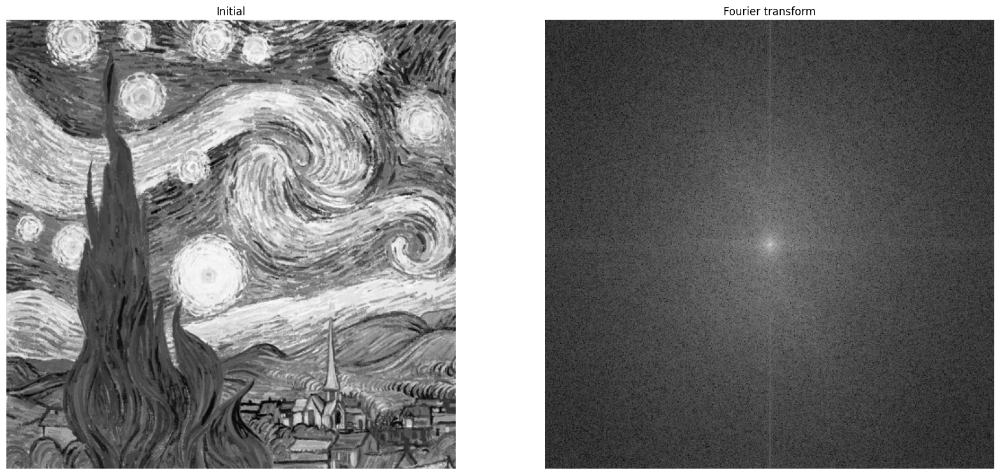

In [33]:
fig, axs = plt.subplots(1, 2, figsize=(20,20))
axs[0].imshow(image_paint, cmap="gray")
axs[0].title.set_text(f'Initial')
axs[0].axis("off")

axs[1].imshow(get_fft_image(fft(image_paint)), 
              cmap="gray")
axs[1].title.set_text(f'Fourier transform')
axs[1].axis("off")
plt.show()

Рассмотрим ДПФ синусоидального изображения. 
В одномерном случае, рассмотренные ранее волны являются суммой основных синусоидальных волн нескольких частот (например, от двух источников звука). Благодаря преобразованию Фурье можно увидеть, из волн каких частот состоит результирующий сигнал. 
То же самое относится к Фурье преобразованию изображений. Мы также можем видеть изображения как трехмерные поверхности, если мы примем значение каждого пикселя как значения по оси Z. То есть в пространстве x-y-z можно разместить изображение на плоскости x-y, а затем построить поверхность, высота которой в точке (x, y) является значением пикселя в этой позиции. По своей сути, изображения также являются результатом наложения двумерных волн с различными частотами.

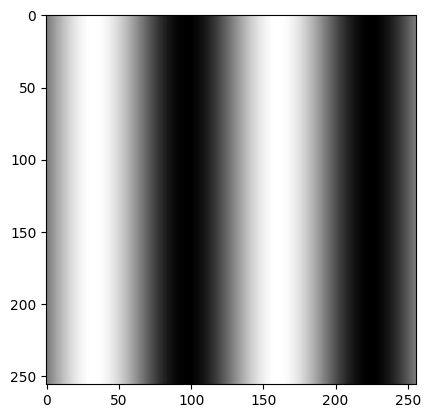

In [34]:
N = 256
x = np.linspace(-np.pi,np.pi, N)
sine1D = 128.0 + (127.0 * np.sin(x * 2.0))
sine1D = np.uint8(sine1D)
sine2D = np.ndarray((N,N), dtype=np.uint8)
for i in range(N):
#     sine2D[i]= np.roll(sine1D,i)  # shift the 1D sin data by -i, -i increases with rows
    sine2D[i]= np.roll(sine1D,1)  # shift the 1D sin data by -i, -i increases with rows

plt.imshow(sine2D, cmap='gray')
plt.show()

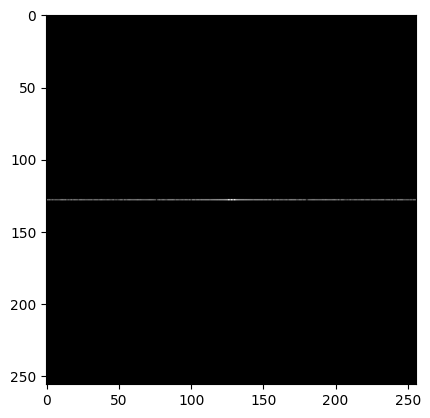

In [35]:
plt.imshow(get_fft_image(fft(sine2D)), cmap='gray')
plt.show()

Но есть одно различие между одномерным и двумерным преобразованием Фурье. Дело в том, что при двумерном преобразовании Фурье или преобразовании Фурье изображения у нас есть частоты как по оси x, так и по оси y. В приведенном выше примере изображения мы видим изменения паттерна только по оси X. Следовательно, изображение не имеет частоты направления Y, и поэтому преобразование Фурье этого изображения выглядит так, как показано на рисунке ниже. Вы можете видеть, что у него белые пиксели (более высокие значения) только вдоль оси X, а все остальные пиксели все черные (нулевые значения).  
Если на изображении нет изменений интенсивностей, например, присутствует только черный или белый фон, то преобразование Фурье будет выглядеть как на изображении ниже. В центре всего один светящийся пиксель. Центральный пиксель совпадает с нулем Гц.

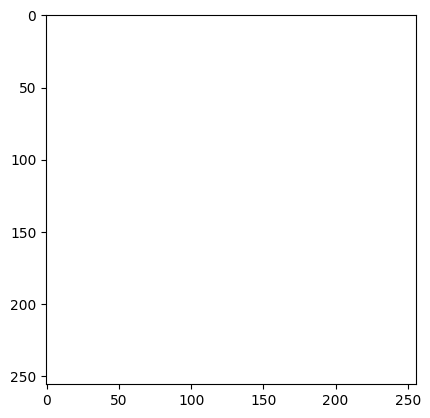

In [36]:
im_plane = np.full((256, 256), 255, dtype=np.uint8)
plt.imshow(im_plane, cmap='gray', vmin=0, vmax=255)
plt.show()

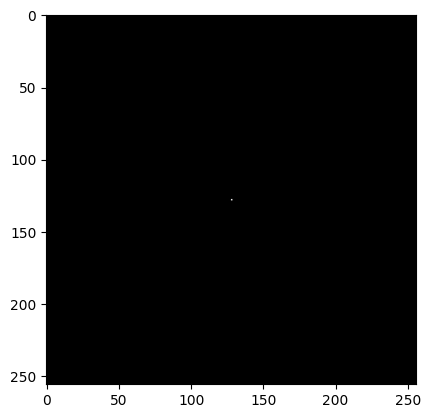

In [37]:
plt.imshow(get_fft_image(fft(im_plane)), cmap='gray')
plt.show()

## 2.2. Применение ФНЧ в частотной области
Если мы удалим высокочастотные компоненты из изображения в частотной области, а затем применим к нему обратное преобразование Фурье, мы можем получить размытое изображение. Это принцип фильтра нижних частот изображения.  
После применения к изображению фильтра нижних частот отфильтрованное изображение в частотной области восстанавливается в пиксельное изображение, которое является размытой версией исходного изображения.
<img src="https://miro.medium.com/max/1050/1*gxUNf1jfdcvrNmNpHp-hRg.png" width="600" height="600"> 

Фактически, фильтр нижних частот - это просто полутоновое изображение, значения которого выше около центра и близки к нулю снаружи. Поэтому фильтры нижних частот обычно выглядят как на следующем изображении. Это один из самых популярных фильтров под названием «Окно Хэмминга».

Таким образом, __пайплайн частотной обработки включает в себя следующие операции__:
1. Выполнить преобразование Фурье для преобразования серошкального изображения в частотное пространство;
2. Визуализировать и отцентрировать компоненты нулевой частоты;
3. Применить фильтр низких / высоких частот;
4. Выполнить децентрализацию в частотной области;
5. Реализовать обратное преобразование Фурье для генерации изображения.

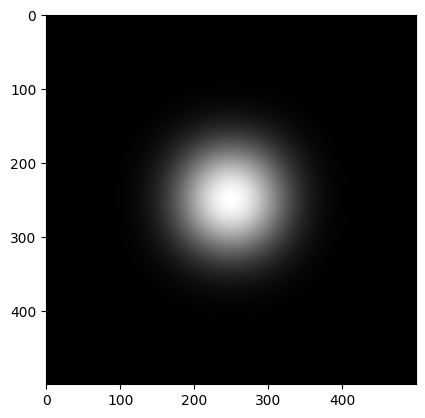

In [38]:
r = 10 # how narrower the window is
ham = np.hamming(image_paint.shape[0])[:,None] # 1D hamming
ham2d = np.sqrt(np.dot(ham, ham.T)) ** r # expand to 2D hamming

plt.imshow(ham2d, cmap='gray')
plt.show()

Затем мы умножаем это полутоновое изображение на преобразование Фурье исходного изображения. Мы получаем еще одно изображение в частотной области, значения внешней стороны которого сведены к нулю. Это означает, что высокочастотные компоненты удаляются, а низкочастотные компоненты остаются неизменными.
Ниже приводится сравнение исходного преобразованного изображения и отфильтрованного. Вы можете видеть, что более высокочастотная составляющая (внешняя сторона) удаляется и становится темнее.

In [39]:
f_complex = fft(image_paint)
f_filtered = ham2d * f_complex

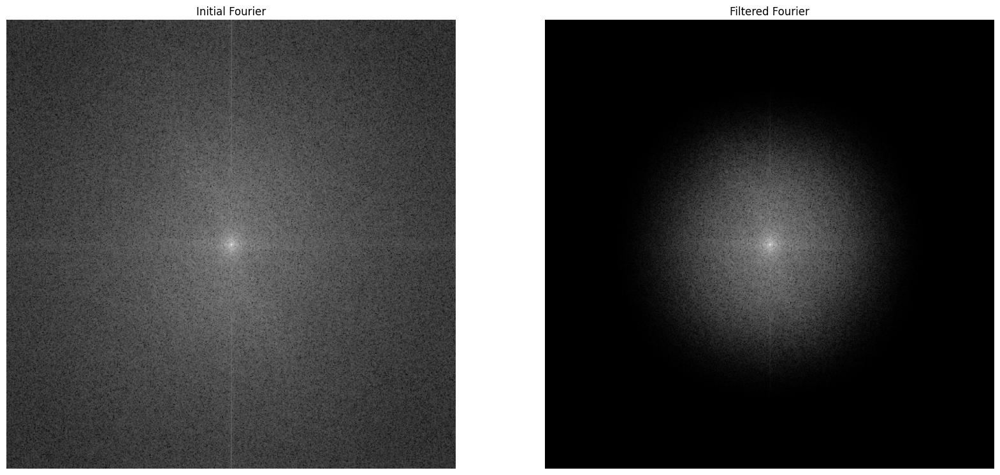

In [40]:
fig, axs = plt.subplots(1, 2, figsize=(20,20))
axs[0].imshow(get_fft_image(f_complex), cmap="gray")
axs[0].title.set_text(f'Initial Fourier')
axs[0].axis("off")

axs[1].imshow(get_fft_image(f_filtered), cmap="gray")
axs[1].title.set_text(f'Filtered Fourier')
axs[1].axis("off")
plt.show()

In [41]:
f_filtered_shifted = np.fft.ifftshift(f_filtered)
inv_img = np.fft.ifft2(f_filtered_shifted) # inverse F.T.


# Get absolute value
filtered_img = np.abs(inv_img)
filtered_img -= filtered_img.min()
filtered_img = filtered_img*255 / filtered_img.max()
filtered_img = filtered_img.astype(np.uint8)

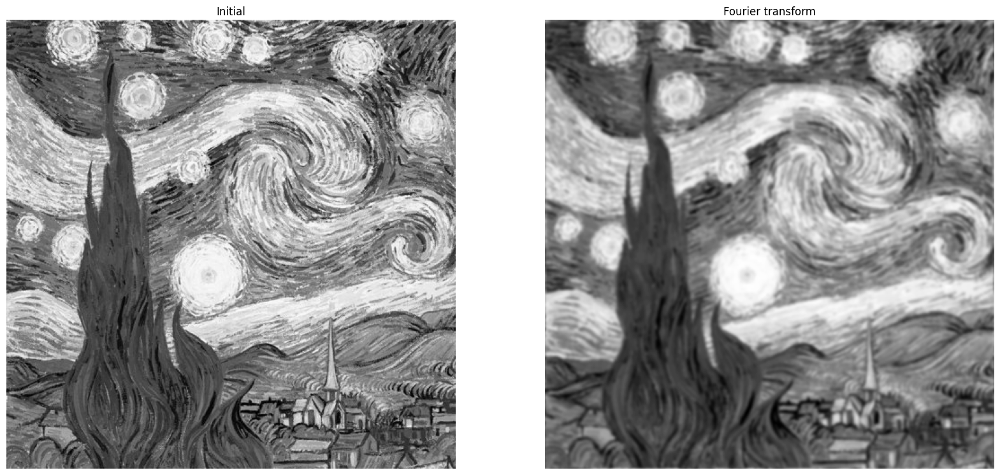

In [42]:
fig, axs = plt.subplots(1, 2, figsize=(20,20))
axs[0].imshow(image_paint, cmap="gray")
axs[0].title.set_text(f'Initial')
axs[0].axis("off")

axs[1].imshow(filtered_img, cmap="gray")

axs[1].title.set_text(f'Fourier transform')
axs[1].axis("off")
plt.show()

## 2.3. Поэтапное применение фильтров в частотной области
### Шаг 1. Вычисление 2-мерного быстрого преобразования Фурье
Результатом процесса БПФ является комплексный числовой массив, который очень трудно визуализировать напрямую. Следовательно, мы должны преобразовать его в двухмерное пространство. Вот два способа визуализации результата БПФ: 1. Спектр 2. Фазовый угол.  
На рисунке спектра в четырех углах есть несколько симметричных узоров. Эти узоры можно перенести в центр изображения на следующем этапе.
Белая область на изображении спектра показывает высокую частоту. Углы на изображении спектра представляют низкие частоты. Таким образом, при объединении двух приведенных выше точек белая область в углу указывает на наличие высокой энергии на низких / нулевых частотах, что является нормальной ситуацией для большинства изображений.
С другой стороны, трудно выделить какие-либо заметные закономерности на фазовом рисунке. Это не означает, что фазовый угол БПФ совершенно бесполезен, потому что фаза сохраняет характеристики формы, которые являются необходимой информацией для изображения.

### Шаг 2. Смещение компоненты нулевой частоты в центр спектра
Двумерное БПФ имеет свойства сдвига и вращения, поэтому мы можем сдвигать частоту без потери какой-либо информации. Данный подход применяется для того, чтобы сделать изображение спектра более видимым для человека. Более того, этот подход может помочь нам легко реализовать фильтр высоких / низких частот.

### Шаг 3. Применение фильтров в частотной области
Необходимо задать форму фильтра (см. далее) в виде матрицы, которую затем требуется поэлементно перемножить со спектром изображения.

### Шаг 4. Обратный шагу 2. Вернуть компонент нулевой частоты в исходное положение. 

### Шаг 5. Обратный шагу 1. Вычислить 2-мерное обратное преобразование Фурье

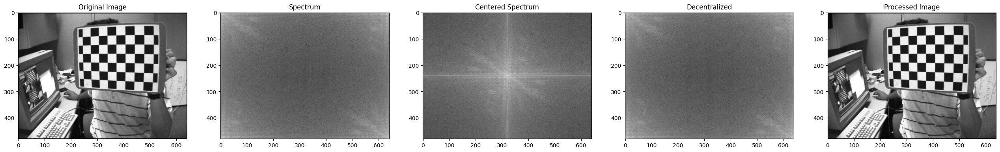

In [43]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

img = cv2.imread("image_for_filtering.jpg", 0)
plt.subplot(151), plt.imshow(img, "gray"), plt.title("Original Image")

original = np.fft.fft2(img)
plt.subplot(152), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

center = np.fft.fftshift(original)
plt.subplot(153), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

inv_center = np.fft.ifftshift(center)
plt.subplot(154), plt.imshow(np.log(1+np.abs(inv_center)), "gray"), plt.title("Decentralized")

processed_img = np.fft.ifft2(inv_center)
plt.subplot(155), plt.imshow(np.abs(processed_img), "gray"), plt.title("Processed Image")

plt.show()

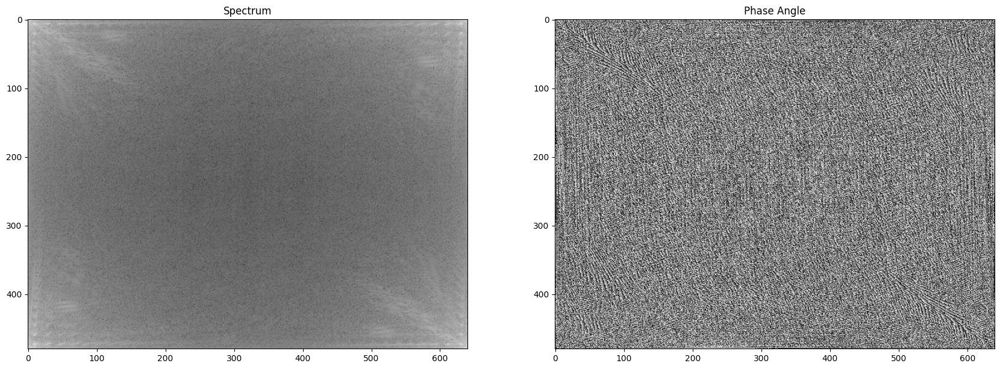

In [44]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)
original = np.fft.fft2(img)
plt.subplot(131), plt.imshow(np.log(np.abs(original)), "gray"), plt.title("Spectrum")

plt.subplot(132), plt.imshow(np.angle(original), "gray"), plt.title("Phase Angle")
plt.show()

### Фильтры нижних частот
Фильтр низких частот - это фильтр, который пропускает только низкие частоты. Низкие частоты на изображениях означают, что значения пикселей меняются медленно. Например, сглаженная область с небольшим изменением цвета на изображении, такая как центр чистого белого листа бумаги, считается низкочастотным содержимым.  
Поскольку выходной сигнал фильтра нижних частот пропускает только низкие частоты, высокочастотное содержимое, такое как шумы, блокируется, что делает обработанное изображение менее зашумленным. Поэтому фильтр нижних частот широко используется для удаления шумов на изображениях.

### Фильтры верхних частот
Фильтр высоких частот, напротив, является фильтром, который пропускает только высокие частоты. Высокие частоты в изображениях означают, что значения пикселей резко меняются. Например, краевые области изображения с изменением цвета, такие как край между двумя объектами, считаются высокочастотным содержимым.  
Выходной сигнал фильтра высоких частот захватывает края изображения, которые можно использовать для повышения резкости исходного изображения с правильным вычислением перекрытия.  
Фильтр нижних частот сохраняет общую информацию в изображении. С другой стороны, фильтр верхних частот пытается подчеркнуть изменения в изображении.

### Типы фильтров
__Идеальный ФНЧ__ 
<img src="https://miro.medium.com/max/702/1*Y4j7yhCuxT8xbn7I6ATpzg.png" width="300" height="300"> 
Идея, лежащая в основе идеального фильтра, очень проста: учитывая значение радиуса D0 в качестве порога, фильтр нижних частот на рисунке имеет H(u, v), равный 1 под порогом, и H (u, v) равно 0 при превышении порога.  

__Идеальный ФВЧ__
<img src="https://miro.medium.com/max/807/1*SckaHFSMmrH40uvJggK6Rg.png" width="300" height="300"> 

In [45]:
def distance(point1,point2):
    return sqrt((point1[0]-point2[0])**2 + (point1[1]-point2[1])**2)

def idealFilterLP(D0,imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            if distance((y,x),center) < D0:
                base[y,x] = 1
    return base

def idealFilterHP(D0,imgShape):
    base = np.ones(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            if distance((y,x),center) < D0:
                base[y,x] = 0
    return base

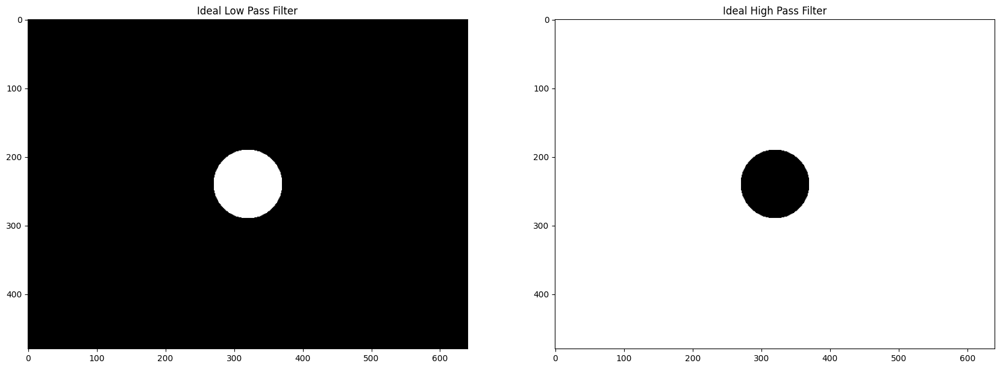

In [46]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

LowPass = idealFilterLP(50,img.shape)
plt.subplot(131), plt.imshow(LowPass, "gray"), plt.title("Ideal Low Pass Filter")

HighPass = idealFilterHP(50,img.shape)
plt.subplot(132), plt.imshow(HighPass, "gray"), plt.title("Ideal High Pass Filter")

plt.show()

__ФНЧ Баттерворта__  
<img src="https://miro.medium.com/max/677/1*mZ3a_7lYeJCdHkhST5O4qQ.png" width="300" height="300">
В отличие от идеального фильтра, фильтр Баттерворта не имеет резких разрывов, которые дают четкую границу между прошедшими и отфильтрованными частотами. Фильтр Баттерворта вводит в функцию новый параметр n. Изменение n влияет на четкость среза между прошедшими и отфильтрованными частотами.  

__ФВЧ Баттерворта__
<img src="https://miro.medium.com/max/675/1*9QI2eRMTKD77gASK1ICEZQ.png" width="300" height="300">

In [47]:
def distance(point1,point2):
    return sqrt((point1[0]-point2[0])**2 + (point1[1]-point2[1])**2)

def butterworthLP(D0,imgShape,n):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = 1/(1+(distance((y,x),center)/D0)**(2*n))
    return base

def butterworthHP(D0,imgShape,n):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = 1-1/(1+(distance((y,x),center)/D0)**(2*n))
    return base

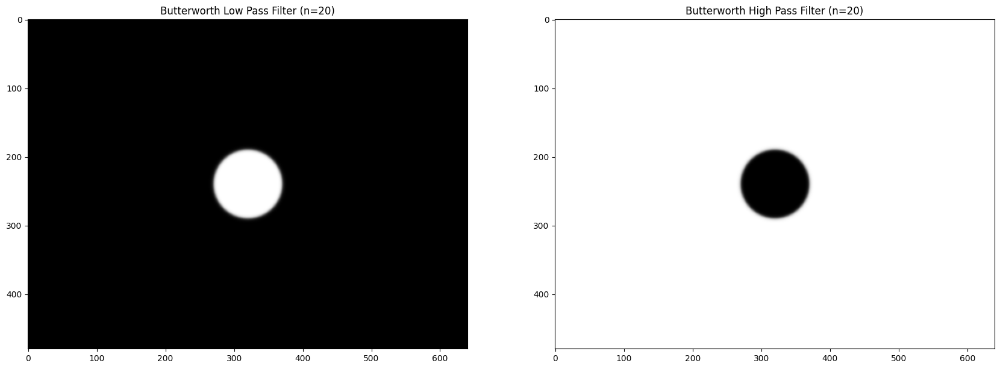

In [48]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

LowPass = butterworthLP(50,img.shape,20)
plt.subplot(131), plt.imshow(LowPass, "gray"), plt.title("Butterworth Low Pass Filter (n=20)")

HighPass = butterworthHP(50,img.shape,20)
plt.subplot(132), plt.imshow(HighPass, "gray"), plt.title("Butterworth High Pass Filter (n=20)")

plt.show()

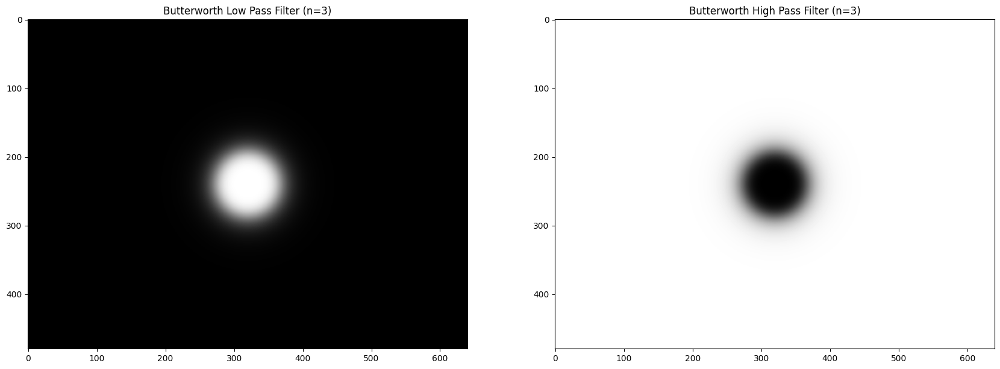

In [49]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

LowPass = butterworthLP(50,img.shape,3)
plt.subplot(131), plt.imshow(LowPass, "gray"), plt.title("Butterworth Low Pass Filter (n=3)")

HighPass = butterworthHP(50,img.shape,3)
plt.subplot(132), plt.imshow(HighPass, "gray"), plt.title("Butterworth High Pass Filter (n=3)")

plt.show()

__Гауссов ФНЧ__
<img src="https://miro.medium.com/max/515/1*bwx_xl-Bu2kUpt0mQMJ5Zw.png" width="300" height="300">
Фильтр Гаусса - обладает более гладким срезом частот, чем фильтр Баттерворта. Граница между прошедшими и отфильтрованными частотами очень размыта, что приводит к более аккуратной обработке изображений.  

__Гауссов ФВЧ__
<img src="https://miro.medium.com/max/569/1*QTLcvYY-MMqJ08vZ1WzMNA.png" width="300" height="300">

In [50]:
def distance(point1,point2):
    return sqrt((point1[0]-point2[0])**2 + (point1[1]-point2[1])**2)

def gaussianLP(D0,imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = exp(((-distance((y,x),center)**2)/(2*(D0**2))))
    return base

def gaussianHP(D0,imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = 1 - exp(((-distance((y,x),center)**2)/(2*(D0**2))))
    return base

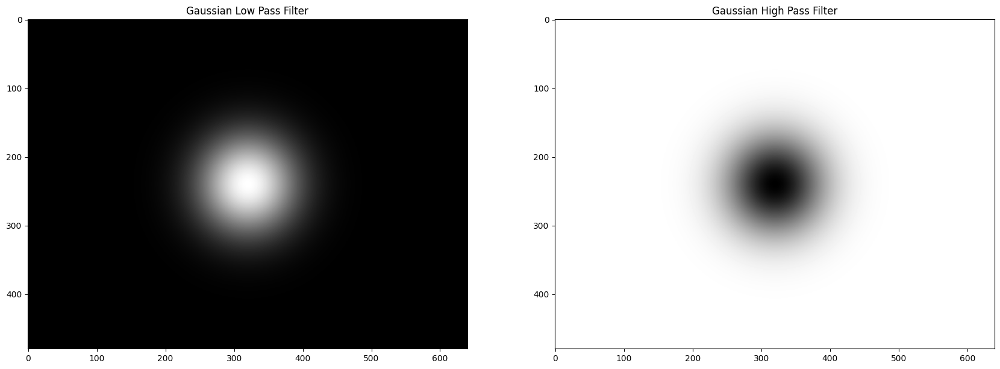

In [51]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

LowPass = gaussianLP(50,img.shape)
plt.subplot(131), plt.imshow(LowPass, "gray"), plt.title("Gaussian Low Pass Filter")

HighPass = gaussianHP(50,img.shape)
plt.subplot(132), plt.imshow(HighPass, "gray"), plt.title("Gaussian High Pass Filter")

plt.show()

### Пример применения ФНЧ

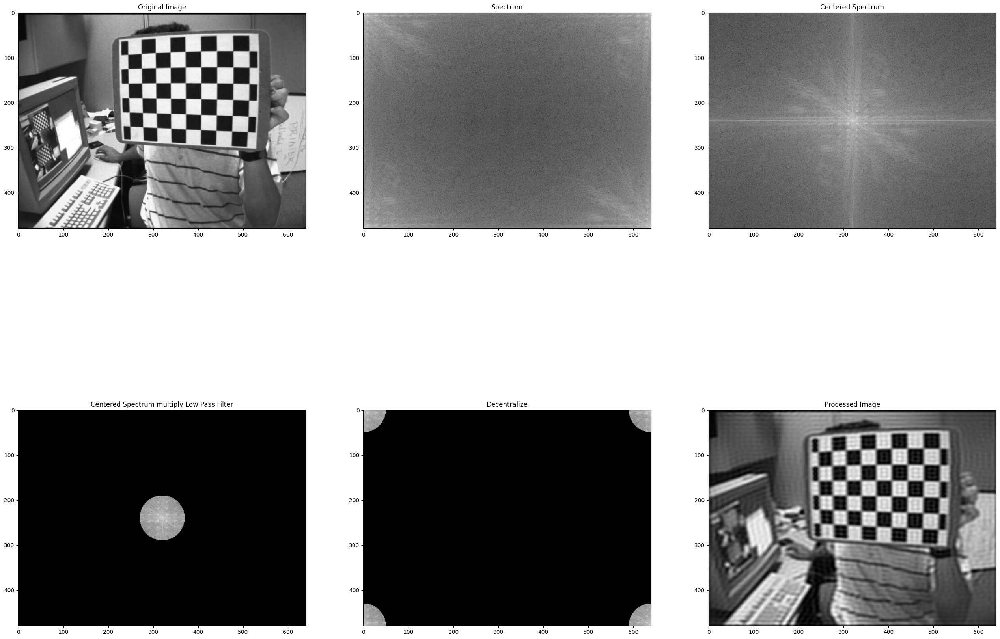

In [52]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

img = cv2.imread("image_for_filtering.jpg", 0)
plt.subplot(231), plt.imshow(img, "gray"), plt.title("Original Image")

original = np.fft.fft2(img)
plt.subplot(232), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

center = np.fft.fftshift(original)
plt.subplot(233), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

LowPassCenter = center * idealFilterLP(50,img.shape)
plt.subplot(234), plt.imshow(np.log(1+np.abs(LowPassCenter)), "gray"), plt.title("Centered Spectrum multiply Low Pass Filter")

LowPass = np.fft.ifftshift(LowPassCenter)
plt.subplot(235), plt.imshow(np.log(1+np.abs(LowPass)), "gray"), plt.title("Decentralize")

inverse_LowPass = np.fft.ifft2(LowPass)
plt.subplot(236), plt.imshow(np.abs(inverse_LowPass), "gray"), plt.title("Processed Image")

plt.show()

### Пример применения ФВЧ

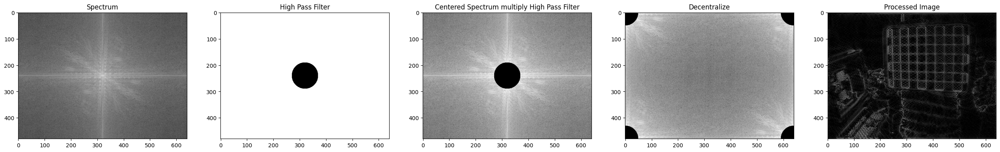

In [53]:
original = np.fft.fft2(img)
center = np.fft.fftshift(original)

plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

plt.subplot(151), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Spectrum")

HighPass = idealFilterHP(50,img.shape)
plt.subplot(152), plt.imshow(np.abs(HighPass), "gray"), plt.title("High Pass Filter")

HighPassCenter = center * idealFilterHP(50,img.shape)
plt.subplot(153), plt.imshow(np.log(1+np.abs(HighPassCenter)), "gray"), plt.title("Centered Spectrum multiply High Pass Filter")

HighPass = np.fft.ifftshift(HighPassCenter)
plt.subplot(154), plt.imshow(np.log(1+np.abs(HighPass)), "gray"), plt.title("Decentralize")

inverse_HighPass = np.fft.ifft2(HighPass)
plt.subplot(155), plt.imshow(np.abs(inverse_HighPass), "gray"), plt.title("Processed Image")

plt.show()

### Сравним эффект от применения различных ФВЧ

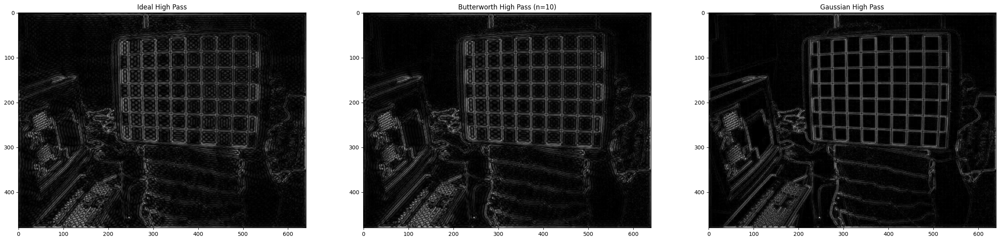

In [54]:
original = np.fft.fft2(img)
center = np.fft.fftshift(original)

plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

HighPassCenter = center * idealFilterHP(50,img.shape)
HighPass = np.fft.ifftshift(HighPassCenter)
inverse_HighPass = np.fft.ifft2(HighPass)
plt.subplot(131), plt.imshow(np.abs(inverse_HighPass), "gray"), plt.title("Ideal High Pass")

HighPassCenter = center * butterworthHP(50,img.shape,10)
HighPass = np.fft.ifftshift(HighPassCenter)
inverse_HighPass = np.fft.ifft2(HighPass)
plt.subplot(132), plt.imshow(np.abs(inverse_HighPass), "gray"), plt.title("Butterworth High Pass (n=10)")

HighPassCenter = center * gaussianHP(50,img.shape)
HighPass = np.fft.ifftshift(HighPassCenter)
inverse_HighPass = np.fft.ifft2(HighPass)
plt.subplot(133), plt.imshow(np.abs(inverse_HighPass), "gray"), plt.title("Gaussian High Pass")

plt.show()

## 2.4. Практический пример устранения шумов в частотной области

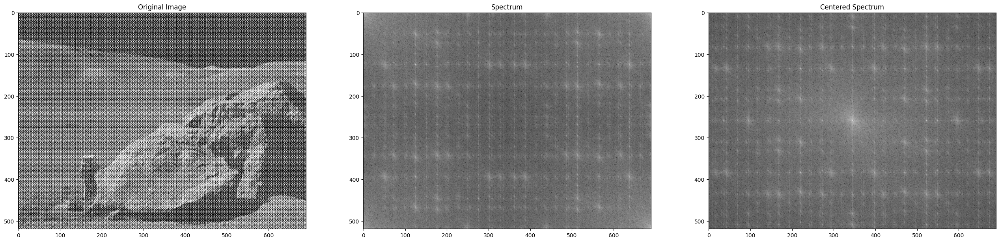

In [55]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)

img = cv2.imread("sin_noised.png", 0)
plt.subplot(131), plt.imshow(img, "gray"), plt.title("Original Image")

original = np.fft.fft2(img)
plt.subplot(132), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

center = np.fft.fftshift(original)
plt.subplot(133), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

plt.show()

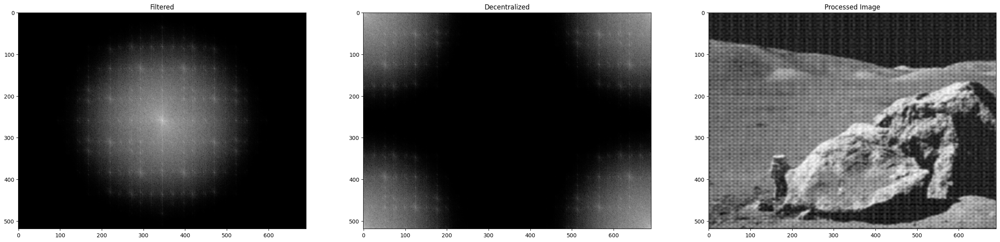

In [56]:
plt.figure(figsize=(6.4*5, 4.8*5), constrained_layout=False)
filtered = center * gaussianLP(50,img.shape)
plt.subplot(131), plt.imshow(np.log(1+np.abs(filtered)), "gray"), plt.title("Filtered")

inv_center = np.fft.ifftshift(filtered)
plt.subplot(132), plt.imshow(np.log(1+np.abs(inv_center)), "gray"), plt.title("Decentralized")

processed_img = np.fft.ifft2(inv_center)
plt.subplot(133), plt.imshow(np.abs(processed_img), "gray"), plt.title("Processed Image")

plt.show()

При подготовке семинара задействованы материалы:
- https://sparkle-mdm.medium.com/contents-list-f89c9700ba8  
- https://hicraigchen.medium.com/digital-image-processing-using-fourier-transform-in-python-bcb49424fd82